# Sea ice characteristics 
In this notebook, we'll highlight variables from the ICESat-2 dataset that describe important characteristics of the sea ice: snow depth, ice type, and snow density. We'll use cartopy and xarray to generate maps and lineplots of the data to demonstrate methods for visualizing the data statically, as opposed to the interactive plotting functions highlighted in the sea ice thickness notebook.

In [1]:
import xarray as xr # For working with gridded climate data 
from utils.read_data_utils import read_book_data # Helper function for reading the data from the bucket
from utils.wrangling_utils import restrictRegionally # Region restriction 
from utils.plotting_utils import static_winter_comparison_lineplot, staticArcticMaps, interactiveArcticMaps, compute_gridcell_winter_means # Plotting utils 

# Plotting dependencies
%config InlineBackend.figure_format = 'retina'
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 150 # Sets figure size in the notebook

# Remove warnings to improve display
import warnings 
warnings.filterwarnings('ignore') 

# 1) Read in the data 

In [2]:
book_ds = read_book_data() # Read/download the data 
book_ds = restrictRegionally(book_ds, regionKeyList=[10,11,12,13,15]) # Restrict data to the Inner Arctic
years = [2018,2019,2020] # Years over which to perform analysis

Regions selected: Inner Arctic


# 2) Map monthly data 
Here, we'll use the `interactiveArcticMaps` function to display the data. You can change the variable to display by changing `data_var` in the code cell below if you run the notebook in Binder. 

In [3]:
data_var = "freeboard"
interactiveArcticMaps(book_ds[data_var], frame_width=500)

:HoloMap   [time]
   :Overlay
      .Coastline.I :Feature   [Longitude,Latitude]
      .QuadMesh.I  :QuadMesh   [longitude,latitude]   (freeboard)

# 3) Map and plot the winter means
Below, we'll compute gridcell means for each month for each variable. Then, we'll plot the means on a map of the Arctic, and display them next to each other for easy visual comparison. 

In [4]:
print(compute_gridcell_winter_means.__doc__) # Print docstring

 Compute winter means over the time dimension. Useful for plotting as the grid is maintained. 
    
    Args: 
        da (xr.Dataset or xr.DataArray): data to restrict by time; must contain "time" as a coordinate 
        years (list of str): years over which to compute mean (default to unique years in the dataset)
        year_start (str, optional): year to start time range; if you want Sep 2019 - Apr 2020, set year="2019" (default to the first year in the dataset)
        start_month (str, optional): first month in winter (default to September)
        end_month (str, optional): second month in winter; this is the following calender year after start_month (default to April)
        force_complete_season (bool, optional): require that winter season returns data if and only if all months have data? i.e. if Sep and Oct have no data, return nothing even if Nov-Apr have data? (default to False) 
    
    Returns: 
        merged (xr.DataArray): DataArray with winter means as a time coord

In [5]:
print(staticArcticMaps.__doc__) # Print docstring

 Show data on a basemap of the Arctic. Can be one month or multiple months of data. 
    Creates an xarray facet grid. For more info, see: http://xarray.pydata.org/en/stable/user-guide/plotting.html
    
    Args: 
        da (xr DataArray): data to plot
        cmap (str, optional): colormap to use (default to viridis)
        col_wrap (int, optional): number of columns of plots to display (default to 3, or None if time dimension has only one value)
        vmin (float, optional): minimum on colorbar (default to 1st percentile)
        vmax (float, optional): maximum on colorbar (default to 99th percentile)
    
    Returns:
        Figure displayed in notebook 
    
    


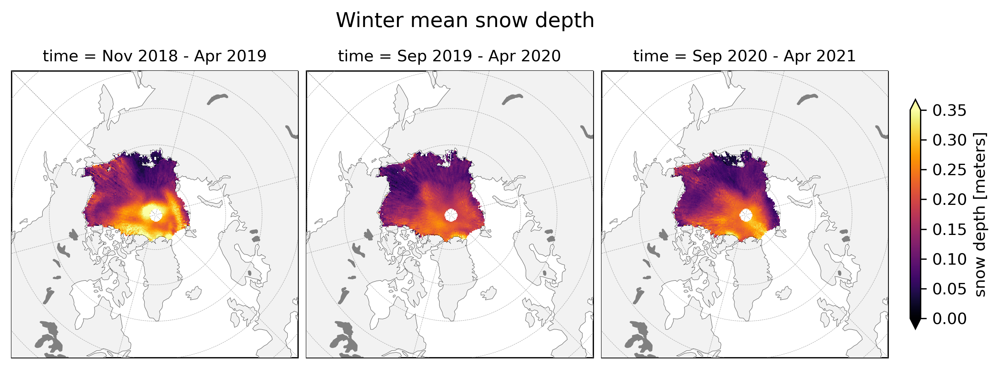

In [6]:
snow_depth_winter_means = compute_gridcell_winter_means(book_ds.snow_depth, years=years)
staticArcticMaps(snow_depth_winter_means, title="Winter mean snow depth", cmap="inferno", vmin=0, vmax=0.35)

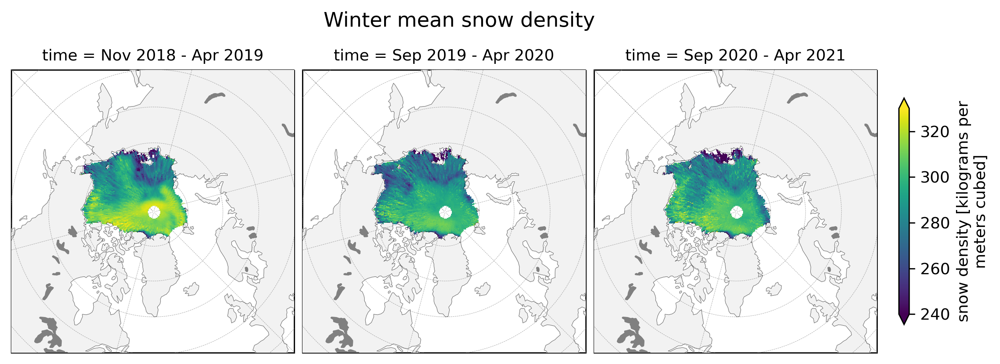

In [7]:
snow_density_winter_means = compute_gridcell_winter_means(book_ds.snow_density, years=years)
staticArcticMaps(snow_density_winter_means, title="Winter mean snow density", cmap="viridis", vmin=240, vmax=330)

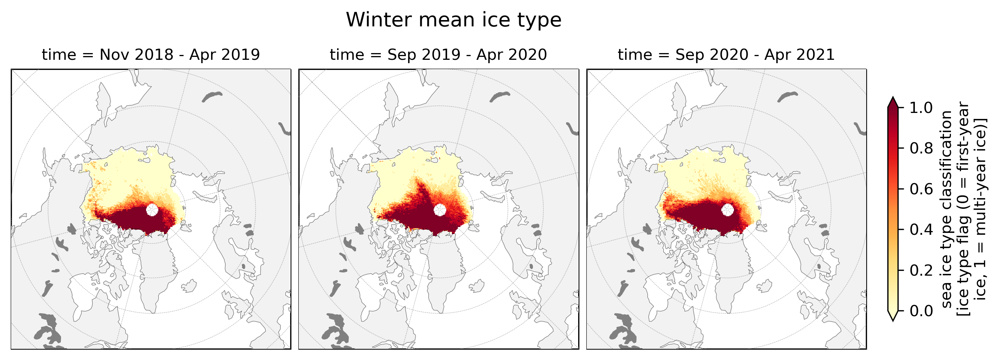

In [8]:
ice_type_winter_means = compute_gridcell_winter_means(book_ds.ice_type, years=years)
staticArcticMaps(ice_type_winter_means, title="Winter mean ice type", cmap="YlOrRd", vmin=0, vmax=1)

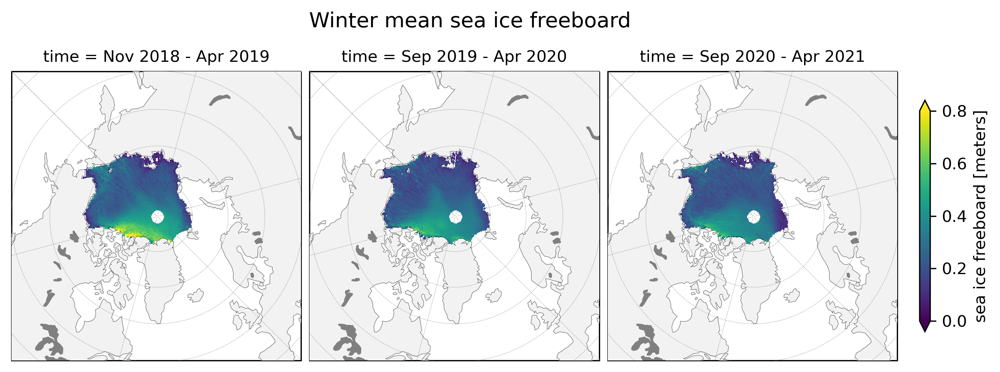

In [9]:
freeboard_winter_means = compute_gridcell_winter_means(book_ds.freeboard, years=years)
staticArcticMaps(freeboard_winter_means, title="Winter mean sea ice freeboard", cmap="viridis", vmin=0, vmax=0.8)

# 3) Monthly mean lineplots 
Next we'll compute the means by averaging over all the gridcells. We'll use this to generate a lineplot to compare across the three winter seasons for each variable.

In [10]:
print(static_winter_comparison_lineplot.__doc__) # Print docstring

 Make a lineplot with markers comparing monthly mean data across winter seasons 
    
    Args: 
        da (xr.DataArray): data to plot and compute mean for; must contain "time" as a coordinate 
        years (list of str): list of years for which to plot data. 2020 would correspond to the winter season defined by start month 2020 - end month 2021 (default to all unique years in da)
        title (str, optional): title to give plot (default to "Winter comparison") 
        figsize (tuple, optional): figure size to display in notebook (default to (5,3))
        start_month (str, optional): first month in winter (default to September)
        end_month (str, optional): second month in winter; this is the following calender year after start_month (default to April)
        force_complete_season (bool, optional): require that winter season returns data if and only if all months have data? i.e. if Sep and Oct have no data, return nothing even if Nov-Apr have data? (default to False) 
     

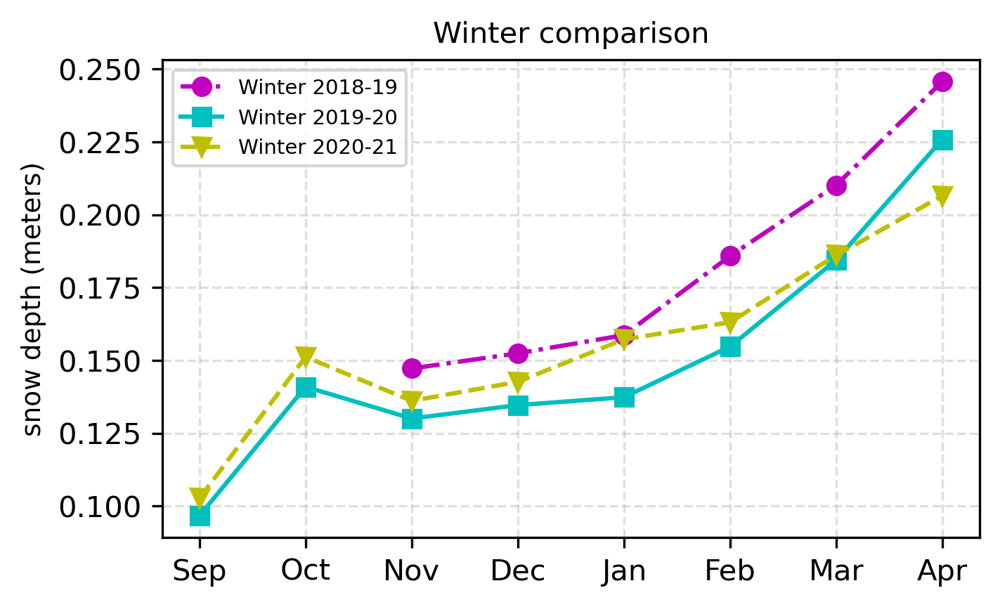

In [11]:
static_winter_comparison_lineplot(book_ds.snow_depth, years=years)

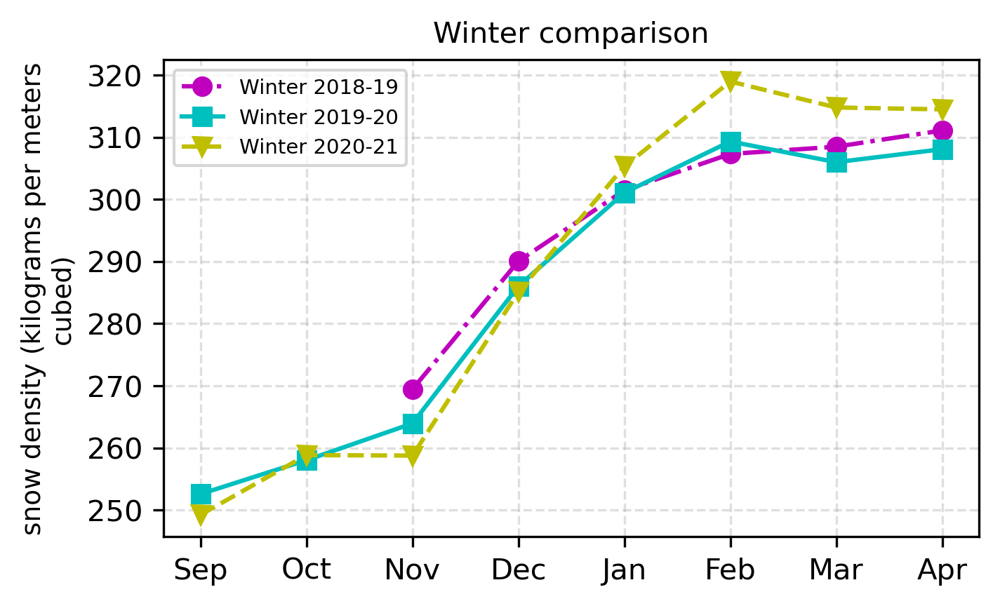

In [12]:
static_winter_comparison_lineplot(book_ds.snow_density, years=years)

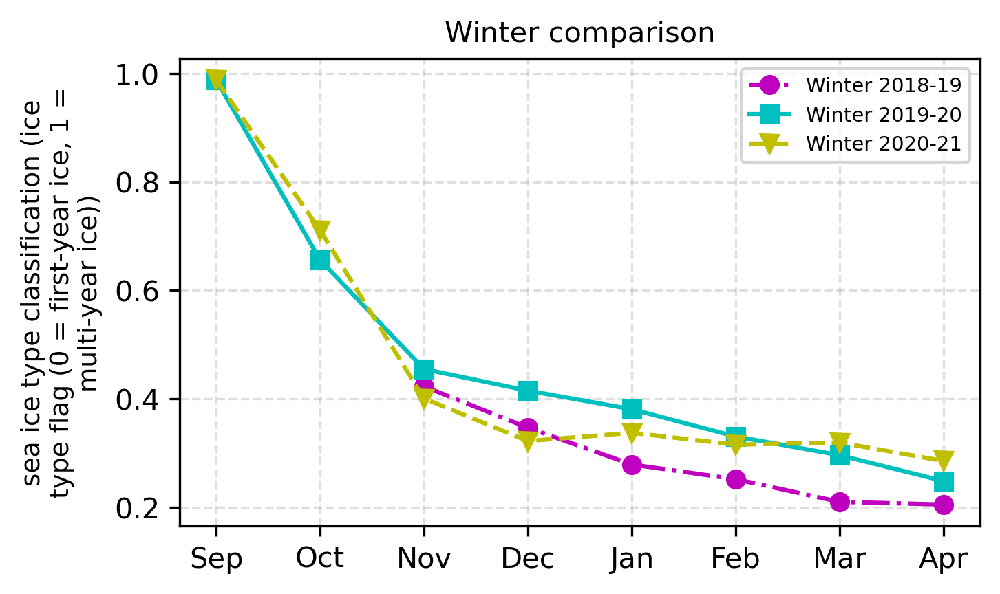

In [13]:
static_winter_comparison_lineplot(book_ds.ice_type, years=years)

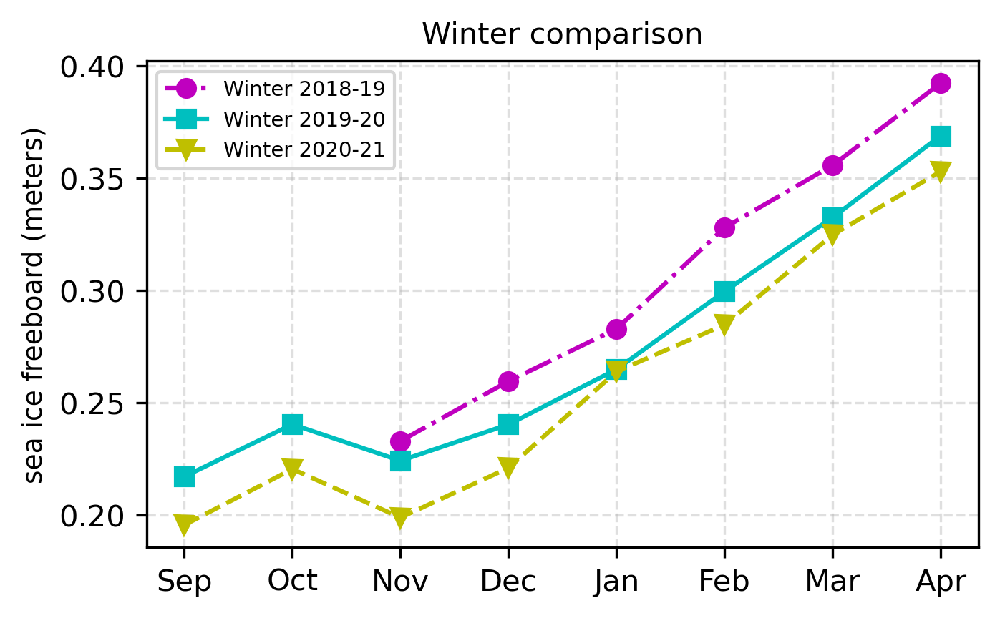

In [14]:
static_winter_comparison_lineplot(book_ds.freeboard, years=years)